In [1]:
#using Pkg; Pkg.instantiate()
using EVQueues, Plots, Random

In [20]:
lambda=150.0;
mu=1.0;
gamma=0.5;
C=75.0;

Tfinal=100.0;

In [21]:
Random.seed!(1234);

edf = ev_edf(lambda,mu,gamma,Tfinal,C)
compute_statistics!(edf)

Random.seed!(1234);

lifo = ev_lifo(lambda,mu,gamma,Tfinal,C)
compute_statistics!(lifo)

Simulando... 100%|██████████████████████████████████████| Time: 0:00:01


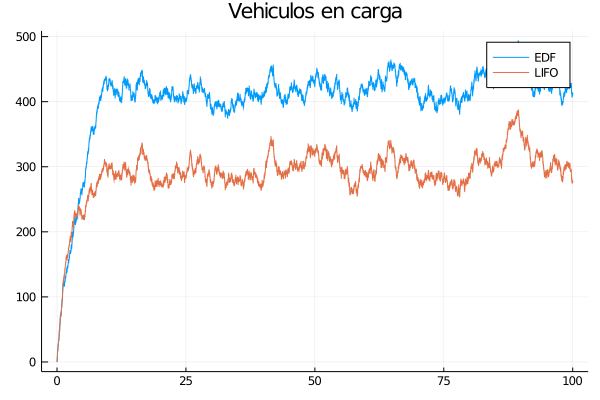

In [22]:
plot(edf.timetrace.T,edf.timetrace.X , label="EDF", title="Vehiculos en carga")
plot!(lifo.timetrace.T,lifo.timetrace.X , label="LIFO")


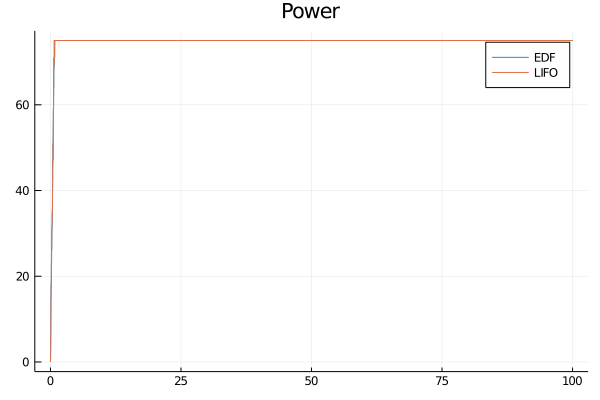

In [23]:
plot(edf.timetrace.T,edf.timetrace.P , label="EDF", title="Power")
plot!(lifo.timetrace.T,lifo.timetrace.P , label="LIFO")


In [36]:
edf_evs = sort(edf.EVs,by=ev->ev.arrivalTime)
lifo_evs = sort(lifo.EVs,by=ev->ev.arrivalTime)

#para recortar el transitorio
n=1000;

edf_evs = edf_evs[n:end]
lifo_evs = lifo_evs[n:end]

S_edf = [ev.requestedEnergy for ev in edf_evs];
S_lifo = [ev.requestedEnergy for ev in lifo_evs];

Sr_edf = [ev.departureWorkload for ev in edf_evs];
Sr_lifo = [ev.departureWorkload for ev in lifo_evs];

Sa_edf = S_edf - Sr_edf
Sa_lifo = S_lifo - Sr_lifo;

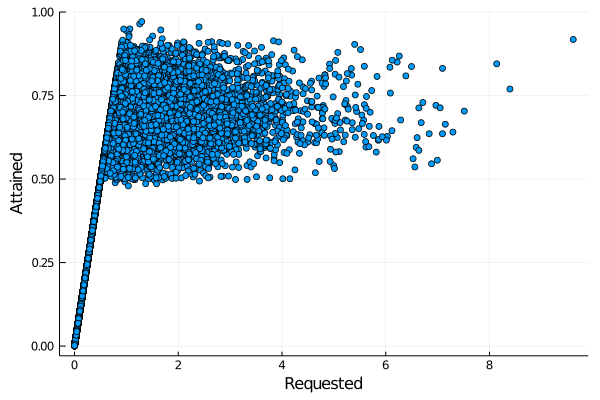

In [37]:
scatter(S_edf,Sa_edf,legend=:none,xlabel="Requested",ylabel="Attained")

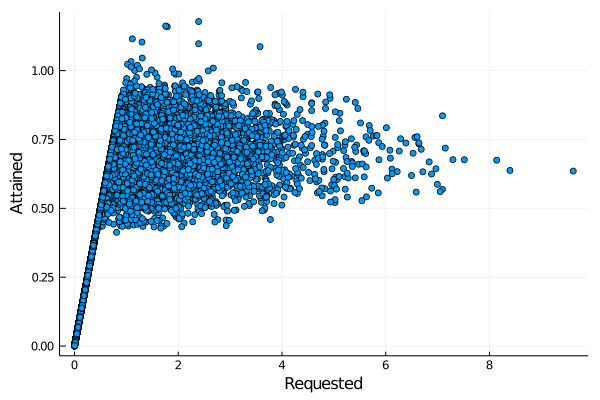

In [38]:
scatter(S_lifo,Sa_lifo,legend=:none,xlabel="Requested",ylabel="Attained")

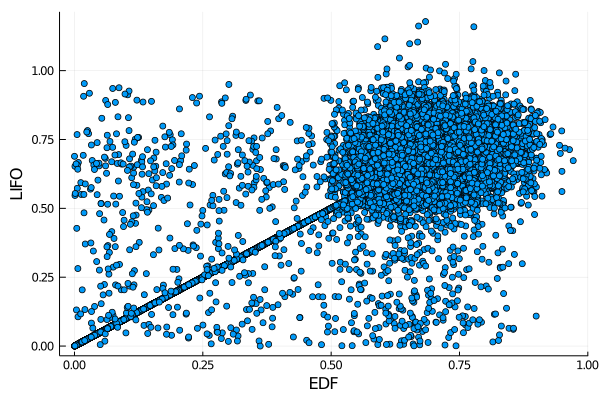

In [39]:
scatter(Sa_edf,Sa_lifo,legend=:none,xlabel="EDF",ylabel="LIFO")